# set up

In [122]:
from ultralytics import YOLO
import os
import cv2
import shutil
import numpy as np
import pandas as pd
from PIL import Image
from tqdm import tqdm
from IPython.display import HTML, Video, Image, clear_output
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import animation, rc
rc('animation', html='jshtml')

In [123]:
!mkdir -p ./output/predict
!mkdir -p ./output/image
!mkdir -p ./output/fig
!mkdir -p ./input/folder1

In [125]:
mp_name = "sample_short.mp4"
save_path = "output"
path_mp1=f"input/folder1/{mp_name}"
path_predicted_mp1=f"{save_path}/predict/{mp_name}"
path_fig=f"{save_path}/fig/"

In [126]:
print(os.listdir('input'))
print(os.listdir('input/folder1'))

['.DS_Store', 'folder1']
['sample_short.mp4']


# YOLOv8

docs: https://docs.ultralytics.com/ja/modes/predict/#inference-arguments

In [113]:
model = YOLO("yolov8x.pt")
results = model.predict(source=path_mp1, conf=0.5, classes=0, save=True, project=save_path,)
# print(len(results))



WARNING ⚠️ inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/178) /Users/shiotsuhiroaki/Desktop/deep_learning/YOLO/input/folder1/sample_short.mp4: 384x640 3 persons, 628.1ms
video 1/1 (frame 2/178) /Users/shiotsuhiroaki/Desktop/deep_learning/YOLO/input/folder1/sample_short.mp4: 384x640 3 persons, 601.7ms
video 1/1 (frame 3/178) /Users/shiotsuhiroaki/Desktop/deep_learning/YOLO/input/folder1/sample_short.mp4: 384x640 3 persons, 582.4ms
video 1/1 (frame 4/178) /Users/shiotsuhiroaki/Desktop/deep_l

In [117]:
BOX = pd.DataFrame(columns=['x', 'y', 'x2', 'y2', 'confidence', 'class', 'i'])

# 検出結果を処理
for i, result in enumerate(results):
    # 検出結果が存在するか確認
    if result.boxes is not None and len(result.boxes) > 0:
        
        # 検出結果をnumpy配列に変換し、データフレームに変換
        boxes = result.boxes.xyxy.cpu().numpy()  # xyxy形式の座標を取得
        scores = result.boxes.conf.cpu().numpy()  # 信頼度スコアを取得
        classes = result.boxes.cls.cpu().numpy()  # クラスIDを取得
        
        # numpy配列をデータフレームに変換
        arri = pd.DataFrame(boxes, columns=['x', 'y', 'x2', 'y2'])
        arri['confidence'] = scores
        arri['class'] = classes
        arri['i'] = i
        
        # BOXデータフレームに結合
        BOX = pd.concat([BOX, arri], ignore_index=True)

# データフレームの表示
display(BOX)

/var/folders/_n/m5t3kj1124v40hvjxgz67xb80000gn/T/ipykernel_23757/3763168873.py:20: FutureWarning:

The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.



,x,y,x2,y2,confidence,class,i
0,144.734161,22.379456,390.418488,696.104309,0.943934,0.0,0
1,721.007935,15.927124,960.650391,668.214355,0.916780,0.0,0
2,485.220917,140.168976,577.404541,292.625153,0.700073,0.0,0
3,686.443726,4.799316,957.803345,638.956482,0.939215,0.0,1
4,149.959213,12.317444,390.032227,681.380005,0.938648,0.0,1
...,...,...,...,...,...,...,...
511,538.190674,120.137939,628.496582,262.853058,0.566960,0.0,175
512,68.206543,62.443298,406.461304,712.705566,0.936970,0.0,176
513,836.771851,2.014160,1120.066162,660.750122,0.932125,0.0,176
514,64.359711,62.504822,407.301025,712.106079,0.940420,0.0,177


In [74]:
class_map = {0: u'__background__', 1: u'person', 2: u'bicycle',3: u'car', 4: u'motorcycle', 5: u'airplane', 6: u'bus', 7: u'train', 8: u'truck', 9: u'boat', 10: u'traffic light', 11: u'fire hydrant', 12: u'stop sign', 13: u'parking meter', 14: u'bench', 15: u'bird', 16: u'cat', 17: u'dog', 18: u'horse', 19: u'sheep', 20: u'cow', 21: u'elephant', 22: u'bear', 23: u'zebra', 24: u'giraffe', 25: u'backpack', 26: u'umbrella', 27: u'handbag', 28: u'tie', 29: u'suitcase', 30: u'frisbee', 31: u'skis', 32: u'snowboard', 33: u'sports ball', 34: u'kite', 35: u'baseball bat', 36: u'baseball glove', 37: u'skateboard', 38: u'surfboard', 39: u'tennis racket', 40: u'bottle', 41: u'wine glass', 42: u'cup', 43: u'fork', 44: u'knife', 45: u'spoon', 46: u'bowl', 47: u'banana', 48: u'apple', 49: u'sandwich', 50: u'orange', 51: u'broccoli', 52: u'carrot', 53: u'hot dog', 54: u'pizza', 55: u'donut', 56: u'cake', 57: u'chair', 58: u'couch', 59: u'potted plant', 60: u'bed', 61: u'dining table', 62: u'toilet', 63: u'tv', 64: u'laptop', 65: u'mouse', 66: u'remote', 67: u'keyboard', 68: u'cell phone', 69: u'microwave', 70: u'oven', 71: u'toaster', 72: u'sink', 73: u'refrigerator', 74: u'book', 75: u'clock', 76: u'vase', 77: u'scissors', 78: u'teddy bear', 79: u'hair drier', 80: u'toothbrush'}

In [75]:
BOX['class']=BOX['class'].apply(lambda x: class_map[int(x)+1])
BOX=BOX.reset_index(drop=True)
data0=BOX[BOX['class']=='person']  #[BOX['confidence']>0.01]
data0['i']=data0['i'].apply(lambda x: int(x))
data0['y']=data0['y'].apply(lambda y: -y)
data0=data0.reset_index(drop=True)
data0['j']=data0.index.tolist()
display(data0)
print(len(data0))

,x,y,x2,y2,confidence,class,i
0,144.734161,22.379456,390.418488,696.104309,0.943934,person,0
1,721.007935,15.927124,960.650391,668.214355,0.916780,person,0
2,485.220917,140.168976,577.404541,292.625153,0.700073,person,0
3,686.443726,4.799316,957.803345,638.956482,0.939215,person,1
4,149.959213,12.317444,390.032227,681.380005,0.938648,person,1
...,...,...,...,...,...,...,...
511,538.190674,120.137939,628.496582,262.853058,0.566960,person,175
512,68.206543,62.443298,406.461304,712.705566,0.936970,person,176
513,836.771851,2.014160,1120.066162,660.750122,0.932125,person,176
514,64.359711,62.504822,407.301025,712.106079,0.940420,person,177


class
person    516
Name: count, dtype: int64

In [ ]:
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

In [127]:
# 動画のフレームレートを取得
video_path = path_mp1
cap = cv2.VideoCapture(video_path)
fps = cap.get(cv2.CAP_PROP_FPS)
cap.release()

In [133]:
fps

29.83240223463687

In [132]:
data0['time'] = data0['i'] / fps  
data1=data0[['i', 'time']].copy()
data1['count']=1
data2=data1.groupby(['i','time'],as_index=False).sum()

fig=make_subplots(specs=[[{"secondary_y":False}]])
fig.add_trace(go.Scatter(x=data2['time'],y=data2['count'],name='person'),secondary_y=False,)
fig.update_layout(autosize=False,width=700,height=500,title_text="Number of people detected")
fig.update_xaxes(title_text="order")
fig.update_yaxes(title_text="Number of People",secondary_y=False)
fig.show()

## Sample Code

In [83]:
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

In [84]:
print(data0['x'].min(),data0['x'].max())
print(data0['y'].min(),data0['y'].max())

0.0 929.4745
-250.04010009765625 -0.0


/var/folders/_n/m5t3kj1124v40hvjxgz67xb80000gn/T/ipykernel_23757/64450011.py:3: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

/var/folders/_n/m5t3kj1124v40hvjxgz67xb80000gn/T/ipykernel_23757/64450011.py:3: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

/var/folders/_n/m5t3kj1124v40hvjxgz67xb80000gn/T/ipykernel_23757/64450011.py:3: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

/var/folders/_n/m5t3kj1124v40hvjxgz67xb80000gn/T/ipykernel_23757/64450011.py:3: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

/var/folders/_n/m5t3kj1124v40hvjxgz67xb80000gn/T/ipykernel_23757/64450011.py:3: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

/var/folders/_n/m5t3kj1124v40hvjxgz67xb80000gn/T/ipykernel_23757/64450011.py:3: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

/var/folders/_n/m5t3kj1124v40hvjxgz67xb80000gn

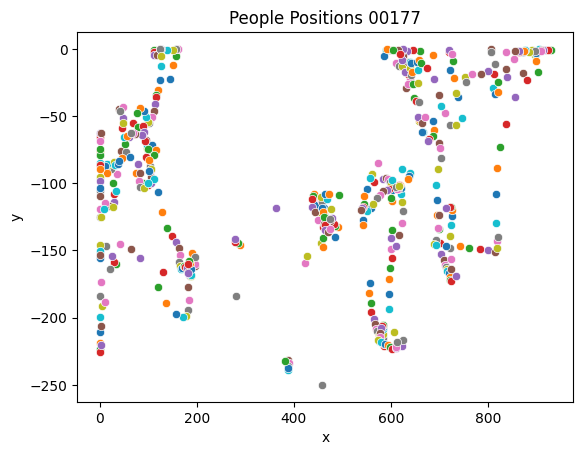

In [81]:
for i in range(len(results)):#len(results)
    #plt.figure(figsize=(8,6))
    sns.scatterplot(data=data0[data0['i']==i], x="x", y="y", palette="Paired") #, hue="i", 
    plt.title("People Positions "+str(i).zfill(5))
    #plt.legend()
    #plt.show()
    plt.savefig(path_fig+str(i).zfill(5)+'.png')

In [85]:
paths3=[]
for dirname, _, filenames in os.walk(path_fig):
    for filename in filenames:
        if filename[-4:]=='.png':
            paths3+=[(os.path.join(dirname, filename))]
paths3=sorted(paths3)
print(paths3[100:103])
images0=[]
for i in tqdm(range(0,len(paths3),2)):
    images0+=[cv2.imread(paths3[i])]

['./output/fig/00100.png', './output/fig/00101.png', './output/fig/00102.png']


100%|██████████| 89/89 [00:00<00:00, 339.58it/s]


In [86]:
def create_animation(ims):
    fig=plt.figure(figsize=(12,8))
    plt.axis('off')
    im=plt.imshow(cv2.cvtColor(ims[0],cv2.COLOR_BGR2RGB))
    plt.close()
    
    def animate_func(i):
        im.set_array(cv2.cvtColor(ims[i],cv2.COLOR_BGR2RGB))
        return [im]

    return animation.FuncAnimation(fig, animate_func, frames=len(ims), interval=1000//10)

create_animation(np.array(images0))

## terminal ver

In [ ]:
model = YOLO("yolov8x.pt")

In [ ]:
!yolo task=detect mode=predict model=yolov8x.pt conf=0.5 source={path_mp1} classes=0 project={save_path}

Ultralytics YOLOv8.2.48 🚀 Python-3.10.4 torch-2.3.1 CPU (Apple M2)
YOLOv8x summary (fused): 268 layers, 68200608 parameters, 0 gradients, 257.8 GFLOPs

video 1/1 (frame 1/178) /Users/shiotsuhiroaki/Desktop/deep_learning/YOLO/input/folder1/sample_short.mp4: 384x640 3 persons, 672.5ms
video 1/1 (frame 2/178) /Users/shiotsuhiroaki/Desktop/deep_learning/YOLO/input/folder1/sample_short.mp4: 384x640 3 persons, 597.5ms
video 1/1 (frame 3/178) /Users/shiotsuhiroaki/Desktop/deep_learning/YOLO/input/folder1/sample_short.mp4: 384x640 3 persons, 593.7ms
video 1/1 (frame 4/178) /Users/shiotsuhiroaki/Desktop/deep_learning/YOLO/input/folder1/sample_short.mp4: 384x640 3 persons, 612.0ms
video 1/1 (frame 5/178) /Users/shiotsuhiroaki/Desktop/deep_learning/YOLO/input/folder1/sample_short.mp4: 384x640 3 persons, 602.8ms
video 1/1 (frame 6/178) /Users/shiotsuhiroaki/Desktop/deep_learning/YOLO/input/folder1/sample_short.mp4: 384x640 3 persons, 585.9ms
video 1/1 (frame 7/178) /Users/shiotsuhiroaki/Desktop/de

In [ ]:
Video(path_predicted_mp1, width=600, height=400, embed=True)

In [ ]:
def video2frames(video_file=path_predicted_mp1, image_dir=path_fig, image_file='img_%s.png'):
    i = 0
    cap = cv2.VideoCapture(video_file)
    while(cap.isOpened()):
        flag, frame = cap.read()
        if flag == False:
            break
        cv2.imwrite(image_dir+image_file % str(i).zfill(5), frame) 
        i += 1
    cap.release()
    
video2frames()

In [ ]:
paths0=[]
for dirname, _, filenames in os.walk(path_fig):
    for filename in filenames:
        if filename[-4:]=='.png':
            paths0+=[(os.path.join(dirname, filename))]
            
images0=[]
for i in tqdm(range(len(paths0))):
    images0+=[cv2.imread(paths0[i])]

100%|██████████| 178/178 [00:02<00:00, 81.02it/s]


In [ ]:
def create_animation(ims):
    fig=plt.figure(figsize=(12,8))
    plt.axis('off')
    im=plt.imshow(cv2.cvtColor(ims[0],cv2.COLOR_BGR2RGB))
    plt.close()
    
    def animate_func(i):
        im.set_array(cv2.cvtColor(ims[i],cv2.COLOR_BGR2RGB))
        return [im]

    return animation.FuncAnimation(fig, animate_func, frames=len(ims), interval=1000//10)

create_animation(np.array(images0))

Animation size has reached 21204713 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
